In [1]:
# load necessary packages
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np # linear algebra
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve, auc, confusion_matrix, classification_report
from sklearn.model_selection import RandomizedSearchCV,GridSearchCV
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

In [5]:
df = pd.read_csv("data/creditcard.csv")

df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [11]:
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", None)

In [12]:
df.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,1.168375e-15,3.416908e-16,-1.379537e-15,2.074095e-15,9.604066e-16,1.487313e-15,-5.556467e-16,1.213481e-16,-2.406331e-15,2.239053e-15,1.673327e-15,-1.247012e-15,8.190001e-16,1.207294e-15,4.887456e-15,1.437716e-15,-3.772171e-16,9.564149e-16,1.039917e-15,6.406204e-16,1.654067e-16,-3.568593e-16,2.578648e-16,4.473266e-15,5.340915e-16,1.683437e-15,-3.660091e-16,-1.227390e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,1.088850e+00,1.020713e+00,9.992014e-01,9.952742e-01,9.585956e-01,9.153160e-01,8.762529e-01,8.493371e-01,8.381762e-01,8.140405e-01,7.709250e-01,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,-2.458826e+01,-4.797473e+00,-1.868371e+01,-5.791881e+00,-1.921433e+01,-4.498945e+00,-1.412985e+01,-2.516280e+01,-9.498746e+00,-7.213527e+00,-5.449772e+01,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,-5.354257e-01,-7.624942e-01,-4.055715e-01,-6.485393e-01,-4.255740e-01,-5.828843e-01,-4.680368e-01,-4.837483e-01,-4.988498e-01,-4.562989e-01,-2.117214e-01,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,-9.291738e-02,-3.275735e-02,1.400326e-01,-1.356806e-02,5.060132e-02,4.807155e-02,6.641332e-02,-6.567575e-02,-3.636312e-03,3.734823e-03,-6.248109e-02,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,4.539234e-01,7.395934e-01,6.182380e-01,6.625050e-01,4.931498e-01,6.488208e-01,5.232963e-01,3.996750e-01,5.008067e-01,4.589494e-01,1.330408e-01,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,2.374514e+01,1.201891e+01,7.848392e+00,7.126883e+00,1.052677e+01,8.877742e+00,1.731511e+01,9.253526e+00,5.041069e+00,5.591971e+00,3.942090e+01,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


In [13]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [14]:
#df["Class"].value_counts(normalize=True)
df['Class'].value_counts(1)

0    0.998273
1    0.001727
Name: Class, dtype: float64

<Axes: xlabel='Class', ylabel='count'>

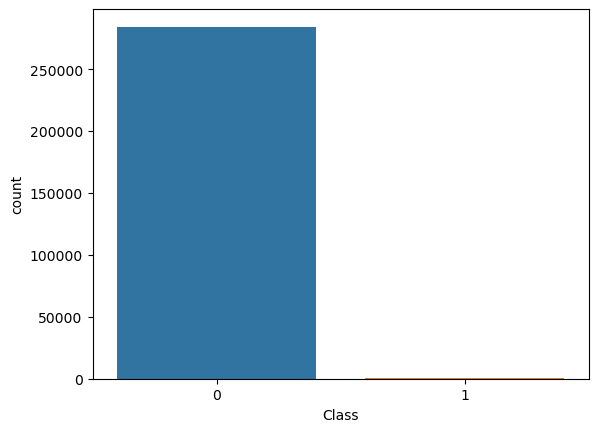

In [10]:
sns.countplot(data = df, x='Class',order = [0,1])

The dataset is highly imbalanced with the non-fradulent class less than 1% in the dataset.

/tmp/ipykernel_32/3543350882.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['Amount'])


<Axes: >

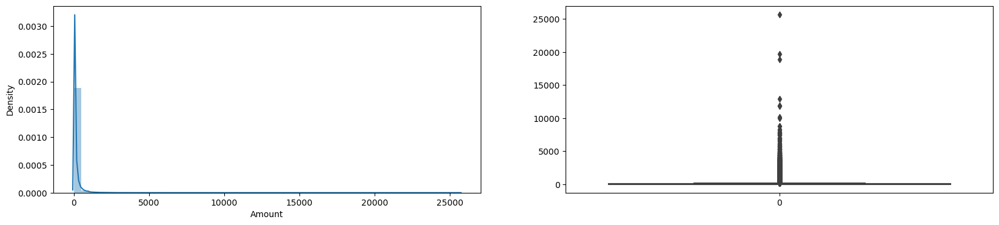

In [5]:
#check the distribution of Amount
f = plt.figure(figsize=(20,4))
f.add_subplot(1,2,1)
sns.distplot(df['Amount'])
f.add_subplot(1,2,2)
sns.boxplot(df['Amount'])


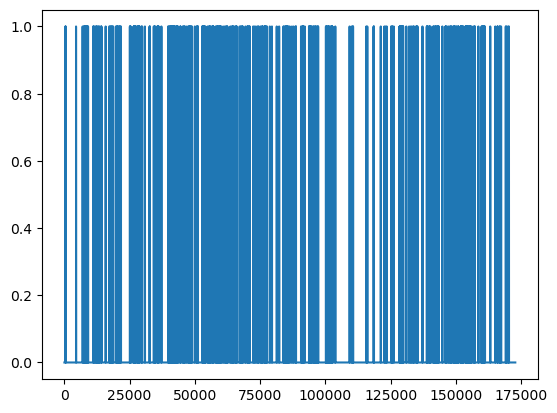

In [17]:
plt.plot(df['Time'],df['Class'])

Text(0, 0.5, 'Class')

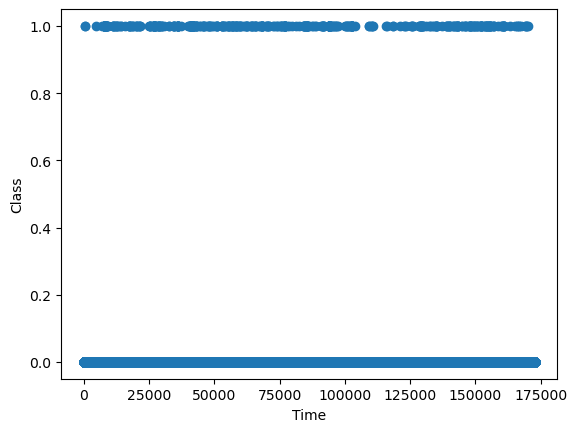

In [21]:
#does time contribute to the fradulent cases

plt.scatter(df['Time'], df['Class'])
plt.xlabel("Time")
plt.ylabel("Class")

In [6]:
#check for duplicated rows and remove them
duplicates = df.duplicated().sum()
df.drop_duplicates(inplace=True)
print(f'There are {duplicates} duplicated rows and {len(df)} unique rows in the dataset')



There are 1081 duplicated rows and 283726 unique rows in the dataset


In [7]:
from sklearn.preprocessing import StandardScaler

df['Amount'] = StandardScaler().fit_transform(df['Amount'].values.reshape(-1, 1))
#df['Std_Amount'] = (df['Amount'] - df['Amount'].mean()) / df['Amount'].std()
#df = df.drop(['Time','Amount'], axis = 1)

In [11]:
X= df.drop(['Time', 'Class'], axis = 1)
y = df['Class']

In [11]:
sns.pairplot(df)

/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Axes: >

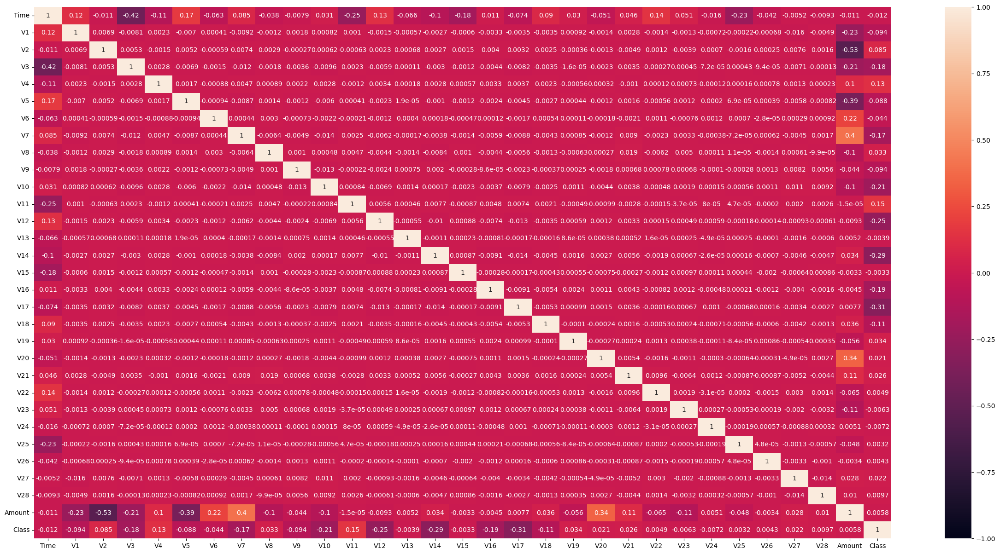

In [18]:
plt.figure(figsize=(30,15))
sns.heatmap(df.corr(), annot = True, vmin=-1, vmax=1)

In [22]:
from imblearn.over_sampling import SMOTE

In [26]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

In [34]:
X_resampled, y_resampled = SMOTE(random_state = 42).fit_resample(X,y)

print(f'The shape of X is: {X_resampled.shape}')
print(f'The distribution of the target class after smoothing: {y_resampled.value_counts()}')

The shape of X is: (566506, 29)
The distribution of the target class after smoothing: 0    283253
1    283253
Name: Class, dtype: int64


In [35]:
# import all models and metrics needed
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import BernoulliNB
from sklearn.metrics import confusion_matrix,precision_recall_curve,accuracy_score,precision_score,f1_score,auc,roc_auc_score,roc_curve,recall_score,classification_report

In [41]:
def make_prediction(model, X= X,y=y):
    X_train,X_test,y_train,y_test = train_test_split(X_resampled, y_resampled, test_size=0.3,random_state = 20)
    model.fit(X_train,y_train)
    
    #get the accuracy of the model on the prediction
    y_pred = model.predict(X_test)
    print((accuracy_score(y_test, y_pred)*100), "is the accuracy of the model")
    
    # get the roc_auc score on prediction
    fpr, tpr, threshold= roc_curve(y_test, y_pred)
    roc_auc = auc(fpr,tpr)
    
    # get the recall score on prediction
    rec = recall_score(y_test,y_pred)
    print("Recall: ", str(rec))
    
    # get the precision score on prediction
    pre = precision_score(y_test, y_pred)
    print("Precision: ",str(pre))
    
    # get f1Score on prediction
    f1Score = f1_score(y_test,y_pred)
    print("F1_Score: ", str(f1Score),'\n')
    
    #get the classification report
    print(f"REPORT________ \n {classification_report(y_test,y_pred)}")
    
    # get confusion matrix for result summarization
    model_cm = confusion_matrix(y_test,y_pred)
    print(model_cm)
    
    
    # display the confusion matrix graphically
    ax= plt.figure(figsize=(5,3))
    cm = sns.heatmap(model_cm, annot = True, cmap="Blues", fmt ="d" )
    cm.set_xlabel("Predicted Value")
    cm.set_ylabel("Actual Value")


93.79824891734137 is the accuracy of the model
Recall:  0.9408358004741628
Precision:  0.9352319759875247
F1_Score:  0.9380255189039807 

REPORT________ 
               precision    recall  f1-score   support

           0       0.94      0.94      0.94     85171
           1       0.94      0.94      0.94     84781

    accuracy                           0.94    169952
   macro avg       0.94      0.94      0.94    169952
weighted avg       0.94      0.94      0.94    169952

[[79647  5524]
 [ 5016 79765]]


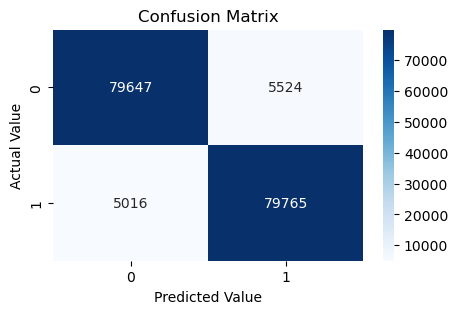

In [35]:
make_prediction(DecisionTreeClassifier(max_depth=6, max_leaf_nodes=10, min_samples_split=20, random_state=42))

90.28196196573151 is the accuracy of the model
Recall:  0.8128943985091
Precision:  0.9906139052191286
F1_Score:  0.8929978231574582 

REPORT________ 
               precision    recall  f1-score   support

           0       0.84      0.99      0.91     85171
           1       0.99      0.81      0.89     84781

    accuracy                           0.90    169952
   macro avg       0.92      0.90      0.90    169952
weighted avg       0.92      0.90      0.90    169952

[[84518   653]
 [15863 68918]]


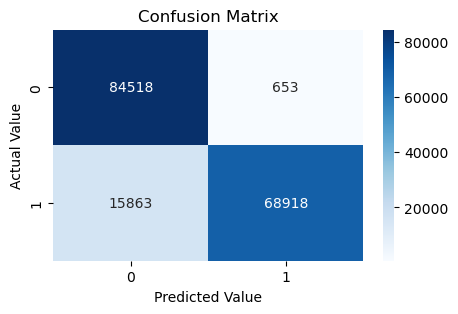

In [36]:
make_prediction(BernoulliNB())

99.90644417247223 is the accuracy of the model
Recall:  1.0
Precision:  0.9981280904167648
F1_Score:  0.9990631683763354 

REPORT________ 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     85171
           1       1.00      1.00      1.00     84781

    accuracy                           1.00    169952
   macro avg       1.00      1.00      1.00    169952
weighted avg       1.00      1.00      1.00    169952

[[85012   159]
 [    0 84781]]


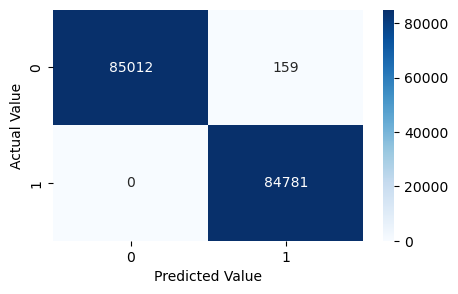

In [40]:
make_prediction(KNeighborsClassifier(n_neighbors= 5, weights= 'distance'))

99.93056863114292 is the accuracy of the model
Recall:  1.0
Precision:  0.9986101131933238
F1_Score:  0.9993045733144743 

REPORT________ 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00     85171
           1       1.00      1.00      1.00     84781

    accuracy                           1.00    169952
   macro avg       1.00      1.00      1.00    169952
weighted avg       1.00      1.00      1.00    169952

[[85053   118]
 [    0 84781]]


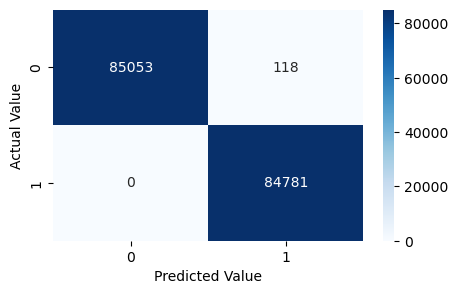

In [41]:
make_prediction(SVC(kernel = 'rbf', gamma = 0.01, C= 100))